<a href="https://colab.research.google.com/github/teddylew12/Waymo_Dataset_Project/blob/transfer_learning/Faster_RCNN_Part_0_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Exploratory Data Analysis**

Welcome! In this notebook  we will explore the Waymo Open dataset including all of the different parts of a single dataset file and statistics about the dataset as a whole.


**Imports** 

First off, youre going to need to upload some of the dataset to your Google Drive, one file is all you will need for this part!

In [0]:
from google.colab import drive
drive.mount('/content/drive')

In [0]:
import os
import tensorflow as tf
import math
import numpy as np
import itertools
import pandas as pd

import matplotlib.pyplot as plt
#Used for creating the bounding boxes
import matplotlib.patches as patches

tf.enable_eager_execution()
!pip install waymo_open_dataset
from waymo_open_dataset.utils import range_image_utils
from waymo_open_dataset.utils import transform_utils
from waymo_open_dataset.utils import  frame_utils
from waymo_open_dataset import dataset_pb2 as open_dataset

**File Structure**

Each file contains 199 consecutive timestamps in a 5-15 second video clip.  In each timestamp, there are images from 5 cameras positioned around the car. 

The Front, Front Left and Front Right cameras have 1920x1280 resolution and the Side Left and Side Right cameras have 1920x886 resolution. 

In addition, there are camera labels that give information like what objects are in the image, and where the objects are.  Each timestamp also has context information, like location, time of day and weather.

First up, I'll show you what one of the full videos looks like.

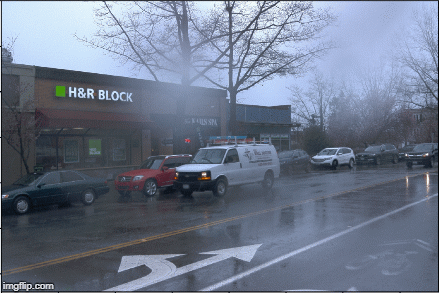

In [6]:

from IPython.display import Image
Image(filename="/content/drive/Shared drives/Waymo Project/raw_images.gif.png")

## Exploring A Single Time Stamp

Each file is in the TFRecord format, which encodes the information as a sequence of binary records that are encoded using Protocol Buffers. The Protocol Buffer is imported as open_dataset and tells Tensorflow how to decode the binary file. 


In [0]:
filename= "/content/drive/Shared drives/Waymo Project/Data/segment-10241508783381919015_2889_360_2909_360_with_camera_labels.tfrecord"

dataset = tf.data.TFRecordDataset(filename, compression_type='')
for data in dataset:
    frame = open_dataset.Frame()
    frame.ParseFromString(bytearray(data.numpy()))
    break

Now that we have a frame, lets first take a look at the context attributes. The attributes are: 
- Laser Object Counts and their types
- Camera Object Counts and their types
- Time of Day
- Location
- Weather

The different types of objects recorded in this dataset are Vehicles, Pedestrians, Bikers, and in Part 4 we will use a deep learning model to classify all of them in an image.

In [10]:
print(frame.context.stats)

laser_object_counts {
  type: TYPE_VEHICLE
  count: 39
}
laser_object_counts {
  type: TYPE_PEDESTRIAN
  count: 12
}
laser_object_counts {
  type: TYPE_SIGN
  count: 31
}
time_of_day: "Night"
location: "location_phx"
weather: "sunny"
camera_object_counts {
  type: TYPE_VEHICLE
  count: 29
}
camera_object_counts {
  type: TYPE_PEDESTRIAN
  count: 11
}



**Images**

Up next, lets take one time stamp and look at the images the camera takes of them. Waymo thankfully already has a prewritten function to do exactly this from their tutorial [Colab notebook](https://colab.research.google.com/github/waymo-research/waymo-open-dataset/blob/r1.0/tutorial/tutorial.ipynb#scrollTo=hDQ1DPqwdfNW).



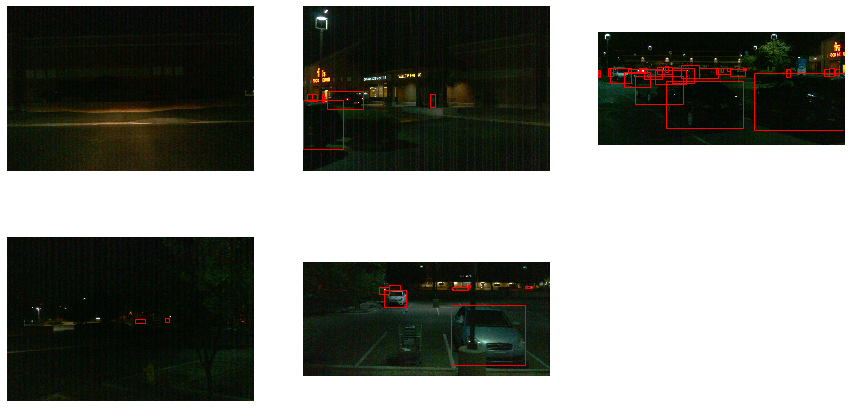

In [14]:
def show_camera_image(camera_image, camera_labels, layout, cmap=None):
  """Show a camera image and the given camera labels."""
  #Create a general area for the output of the function
  ax = plt.subplot(*layout)

  # Draw the camera labels.
  for camera_labels in frame.camera_labels:
    # Ignore camera labels that do not correspond to this camera.
    if camera_labels.name != camera_image.name:
      continue

    # Iterate over the individual labels.
    for label in camera_labels.labels:
      # Draw the object bounding box.
      ax.add_patch(patches.Rectangle(
        xy=(label.box.center_x - 0.5 * label.box.length,
            label.box.center_y - 0.5 * label.box.width),
        width=label.box.length,
        height=label.box.width,
        linewidth=1,
        edgecolor='red',
        facecolor='none'))

  # Show the camera image.
  plt.imshow(tf.image.decode_jpeg(camera_image.image), cmap=cmap)
  #plt.title(open_dataset.CameraName.Name.Name(camera_image.name))
  plt.grid(False)
  plt.axis('off')

  
plt.figure(figsize=(15, 12))

for index, image in enumerate(frame.images):
  show_camera_image(image, frame.camera_labels, [3, 3, index+1])

We can see that some of the images have no objects in them and other have dozens, so our model will need to be able to predict a variable amount of bounding boxes. This means we will need to use a Regional Convolutional Neural Network (RCNN) as opposed to just a vanilla CNN, which normally only produces one prediction per input.

We also see how challenging this object detection can get, the car must be able to pick up objects in pitch black conditions like these.

**Camera Labels**

Up next, we will look at the camera labels that accompany the images.

Each cameras has a list of 0 or more labels. Each label has:
- An unique identifier
- A Class Type
- The coordinates of the bounding box of the object (given in center_x, center_y, length and width)

Some also have difficulty levels, that rank how difficult detection or tracking is for that object based on things like distance from the camera, other objects nearby and occulsion or distortion.

-----Labels-------

name: FRONT_LEFT
labels {
  box {
    center_x: 158.3711925
    center_y: 919.5950399999999
    width: 383.3751299999999
    length: 316.742385
  }
  type: TYPE_VEHICLE
  id: "1c414850-561c-4c8e-9740-e5ea06ec124d"
}
labels {
  box {
    center_x: 329.4810220097336
    center_y: 728.6445124654156
    width: 140.21276946298212
    length: 280.21535982099397
  }
  type: TYPE_VEHICLE
  id: "314cb624-6c00-4a71-bf8c-ed483d296e53"
}
labels {
  box {
    center_x: 92.21213999999998
    center_y: 707.3808
    width: 54.31673999999998
    length: 35.36904
  }
  type: TYPE_PEDESTRIAN
  id: "40d14545-2caa-4aba-8c04-2a965c8db25e"
}
labels {
  box {
    center_x: 155.37113999999997
    center_y: 713.06511
    width: 58.10627999999997
    length: 15.789749999999998
  }
  type: TYPE_PEDESTRIAN
  id: "41f8ffd6-e33e-4668-bf65-e8718390aa80"
}
labels {
  box {
    center_x: 1009.28082
    center_y: 733.9075799999999
    width: 104.21235000000001
    length: 39.7901700000001
  }
  type:

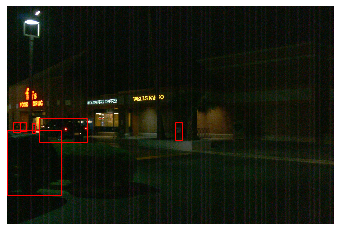

In [31]:
# Lets take a look at the labels from the image in the front left camera
CAMERA_NAMES = ["placeholder","FRONT", "FRONT_LEFT","FRONT_RIGHT","SIDE_LEFT","SIDE_RIGHT"]
img=frame.images[1]
show_camera_image(img, frame.camera_labels[1], [1,1,1])
print("-----Labels-------\n")
print(frame.camera_labels[1])

## Exploring A Single File

Now we move to look at the whole file, totaling 200 timestamps. We will start by making a Pandas dataframe, to put all of this information into a single structured format.

We will be getting 8 pieces of information from each label:

- Frame Number (which of the 200 frames this one is)
- Image Number (which of the 5 cameras it is coming from)
- Object Type
- An unique identifier
- Center_X of object
- Center_Y of object
- Height of object
- Width of object

In [0]:
dataset = tf.data.TFRecordDataset(filename, compression_type='')
# List of Lists (aka 2D matrix) object
list_of_objects = []
#Track which frame we are on
framenum = 0
for data in dataset:
  frame = open_dataset.Frame()
  frame.ParseFromString(bytearray(data.numpy()))
  framenum += 1
  for label in frame.camera_labels:
    #Get the Camera Name
    cam_name = CAMERA_NAMES[label.name]
    for lbl in label.labels:
      #Get the Type of Object and its ID
      obj_class = lbl.type
      obj_id = lbl.id
      #Get the bounding box coordinates
      center_x = lbl.box.center_x
      center_y = lbl.box.center_y
      width = lbl.box.width
      length = lbl.box.length
      #Add as Row to 2D matrix
      list_of_objects.append([framenum, cam_name, obj_class, center_x, 
                     center_y, width, length,obj_id])
    

#Convert to Pandas DataFrame
cols = ["frame_count", "camera_name", "object_class", "center_x", 
        "center_y", "width", "length", "id"]
df = pd.DataFrame(list_of_objects, columns=cols)


Lets look at our DataFrame to make sure it did what we expected.
First, lets check the datatypes that Pandas inferred.

In [78]:
df.dtypes

frame_count       int64
camera_name      object
object_class      int64
center_x        float64
center_y        float64
width           float64
length          float64
id               object
dtype: object

Up next, lets look at the size and a few examples:

In [79]:
df.head()

,frame_count,camera_name,object_class,center_x,center_y,width,length,id
0,1,FRONT_LEFT,1,158.371193,919.595040,383.375130,316.742385,1c414850-561c-4c8e-9740-e5ea06ec124d
1,1,FRONT_LEFT,1,329.481022,728.644512,140.212769,280.215360,314cb624-6c00-4a71-bf8c-ed483d296e53
2,1,FRONT_LEFT,2,92.212140,707.380800,54.316740,35.369040,40d14545-2caa-4aba-8c04-2a965c8db25e
3,1,FRONT_LEFT,2,155.371140,713.065110,58.106280,15.789750,41f8ffd6-e33e-4668-bf65-e8718390aa80
4,1,FRONT_LEFT,2,1009.280820,733.907580,104.212350,39.790170,5186ff87-939e-453a-bab3-637d0b169557


In [80]:
df.shape

(7041, 8)

What have we learned? There are 7041 objects in the 995 images.

Now lets dive in, first to what types of objects are in our dataset

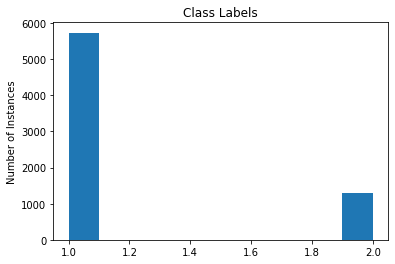

In [61]:
plt.hist(df['object_class'])
plt.title("Class Labels")
plt.ylabel("Number of Instances")
plt.show()

Wow! This file only contains Vehicles (Class 1) and Pedestrains(Class 2), which is to be expected because it is the middle of the night, so there will likely be no bikers out.

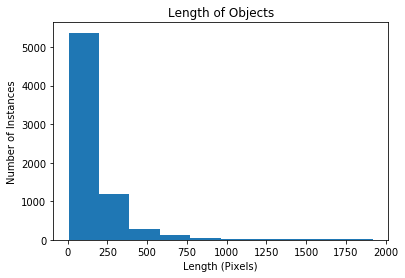

In [66]:
plt.hist(df['length'])
plt.title("Length of Objects")
plt.ylabel("Number of Instances")
plt.xlabel("Length (Pixels)")
plt.show()

The average length of the bounding box is small, but the interesting part of this is the long tail, the fact that some of the boxes seem to take up 1750+ pixels of length, almost the entire camera length. Is this a semi truck? Is this an especially hefty human? Are they just really close to the camera?

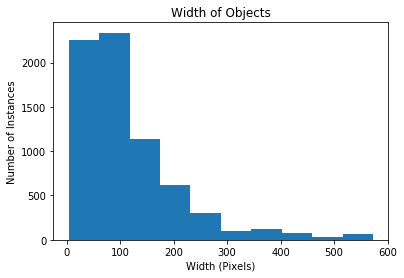

In [67]:
plt.hist(df['width'])
plt.title("Width of Objects")
plt.ylabel("Number of Instances")
plt.xlabel("Width (Pixels)")
plt.show()

The corresponding tail of this graph rules out especially wide people and indicates more liekly that the large objects are simply much closer to the camera than the others.

Now let's look at how crowded (or deserted) some of the frames are!

I will do this using boolean indexing. We go through the dataframe and first we create a boolean mask, which is False unless ```frame_count == i``` for that row. We then use that boolean mask to shrink our dataset to just the ones that match that condition, and count how many row there are. That tells us how many objects there are in a frame!

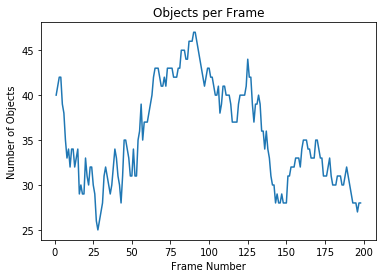

In [82]:
x_axis=np.linspace(1,198,198)
y_axis = []
for i in range(1,199):
  y_axis.append(len(df[df['frame_count']==i]))

plt.plot(x_axis,y_axis)
plt.title("Objects per Frame")
plt.ylabel("Number of Objects")
plt.xlabel("Frame Number")
plt.show()
   

We see that this file has anywhere between 25 to 45 objects to worry about in each frame. But how many of them are unique, or are they all the same object disappering and reappearing?
We can answer this using a pandas function called nunique.

In [81]:
num_unique = df['id'].nunique()
print(f"There are {num_unique} unique objects in this file")

There are 150 unique objects in this file


Cool! Of the 7041 objects, only 150 are unique. This means on average a object is in ```7041/150 = 46``` of the 200 frames.

**Conclusion** <br>
This dataset has so much going on, and I've barely scratched the surface of 2D analysis, let alone all of the 3D lidar data in this dataset. Not to mention Im only looking at one of the hundreds of files that Waymo provided in the dataset. 

In future parts of this series, we will create deep learning models to predict weather and perform object detection tasks using this dataset.

If you made it this far, thanks for reading along! Feel free to shoot me an email at tedlewitt@gmail.com with questions, comments or job offers (especially job offers plz).